In [1]:
from coco import COCO
from coco_labels_paper import labels as coco_labels
import cv2
import os
import time
import random
from itertools import cycle


In [2]:
TRAIN_ANNOTATIONS = 'data/coco2017/annotations/instances_train2017.json'
TRAIN_IMAGES = 'data/coco2017/train2017'
TRAIN_OUTPUT_DIR = 'data/train'
VAL_ANNOTATIONS = 'data/coco2017/annotations/instances_val2017.json'
VAL_IMAGES = 'data/coco2017/val2017'
VAL_OUTPUT_DIR = 'data/validation'

In [31]:
def rescale(cvimg):
    newimg = cv2.resize(cvimg, (224, 224))
    return newimg


def rotate(cvimg):
    newimg = cv2.rotate(cvimg, cv2.cv2.ROTATE_90_CLOCKWISE)
    return newimg


def crop(cvimg, ann):
    bbox = ann['bbox']
    left = int(bbox[0])
    right = int(bbox[0]+bbox[2])
    top = int(bbox[1])
    bottom = int(bbox[1]+bbox[3])
    newimg = cvimg[top:bottom, left:right]
    return newimg


def augment(cvimg):
    newimg = cvimg
    (r, g, b) = cv2.split(newimg)
    r = r*random.uniform(0.8, 1.2)
    g = g*random.uniform(0.8, 1.2)
    b = b*random.uniform(0.8, 1.2)
    newimg = cv2.merge([r,g,b])
    if random.random() > 0.25:
        newimg = cv2.rotate(cvimg, random.choice(ROTATE_DIR))

    return newimg


def ts():
    return str(int(round(time.time() * 1000)))


def generate_dataset(anns_path: str, imgs_path: str, output_dir: str, augment: bool) -> None:
    c = COCO(anns_path)
    print(c)

    amounts = [len(c.getAnnIds(catIds=[i+1])) for i in range(len(coco_labels))]
    print(amounts)


    if not os.path.exists(output_dir):
        os.mkdir(output_dir)

        for cn in coco_labels:
            os.mkdir(f"{output_dir}/{cn}")

        for i, val in enumerate(c.anns):
            ann = c.anns[val]
            print(f'{i} : {len(c.anns)}')

            # skip zero area annotations
            if ann['area'] < 40000:
                continue

            class_name = coco_labels[ann['category_id']-1].strip()
            img = c.loadImgs(ann['image_id'])
            file_name = img[0]['file_name']

            cvimg = cv2.imread(os.path.join(imgs_path, file_name))
            cvimg = crop(cvimg, ann)

            # height, width, channel = cvimg.shape
            # if height > 224 or width > 224:
            #     cvimg = rescale(cvimg)

            cv2.imwrite("{3}/{0}/{2}{1}".format(class_name, file_name,
                                                ts(), output_dir), cvimg)

    if not augment:
        return

    max_amount = max(len(os.listdir("{1}/{0}".format(c, output_dir))) for c in os.listdir(output_dir))
    print(max_amount)

    for folder in os.listdir(output_dir):
        print(folder)
        class_amount = len(os.listdir(f'{output_dir}/{folder}'))

        if class_amount == 0:
            continue

        diff = abs(max_amount - class_amount)

        generated = 0
        gen_cycle = cycle(os.listdir(f'{output_dir}/{folder}'))

        while True:
            f = next(gen_cycle)
            cvimg = cv2.imread(f'{output_dir}/{folder}/{f}')
            cvimg = augment(cvimg)
            cv2.imwrite(f'{output_dir}/{folder}/{ts()}{f}', cvimg)
            generated += 1
            print(f'Generated {generated} for class {folder}')
            if generated >= diff:
                break

In [18]:
generate_dataset(TRAIN_ANNOTATIONS, TRAIN_IMAGES, TRAIN_OUTPUT_DIR, False)
generate_dataset(VAL_ANNOTATIONS, VAL_IMAGES, VAL_OUTPUT_DIR, False)

loading annotations into memory...
Done (t=12.71s)
creating index...
index created!
[262465, 7113, 43867, 8725, 5135, 6069, 4571, 9973, 10759, 12884, 1865, 0, 1983, 1285, 9838, 10806, 4768, 5508, 6587, 9509, 8147, 5513, 1294, 5303, 5131, 0, 8720, 11431, 0, 0, 12354, 6496, 6192, 2682, 6646, 2685, 6347, 9076, 3276, 3747, 5543, 6126, 4812, 24342, 0, 7913, 20650, 5479, 7770, 6165, 14358, 9458, 5851, 4373, 6399, 7308, 7852, 2918, 5821, 7179, 6353, 38491, 5779, 8652, 4192, 0, 15714, 0, 0, 4157, 0, 5805, 4970, 2262, 5703, 2855, 6434, 1673, 3334, 225, 5610, 2637, 0, 24715, 6334, 6613, 1481, 4793, 198, 1954, 0]
0 : 860001
1 : 860001
2 : 860001
3 : 860001
err
4 : 860001
5 : 860001
6 : 860001
7 : 860001
8 : 860001
9 : 860001
10 : 860001
11 : 860001
12 : 860001
13 : 860001
14 : 860001
15 : 860001
16 : 860001
17 : 860001
18 : 860001
19 : 860001
20 : 860001
21 : 860001
22 : 860001
23 : 860001
24 : 860001
25 : 860001
26 : 860001
27 : 860001
28 : 860001
29 : 860001
30 : 860001
31 : 860001
32 : 860001


198
['5779' '0' '1954' '225' '1481' '0' '7113' '5131' '1983' '2682' '262464'
 '4970' '3276' '2637' '7852' '5508' '3747' '4571' '43867' '12883' '24342'
 '2683' '5805' '10758' '1865' '8725' '2262' '0' '198' '7308' '14358'
 '5851' '7913' '6433' '4373' '12353' '11431' '7179' '0' '3334' '20650'
 '6192' '4157' '9076' '10805' '1673' '8652' '4768' '15714' '0' '6165'
 '4793' '6347' '9509' '9973' '5479' '0' '0' '6069' '8720' '4810' '2917'
 '0' '6495' '5610' '6587' '5513' '5703' '2855' '7769' '38490' '8147'
 '6334' '5543' '6353' '6126' '5135' '24715' '9838' '1294' '6399' '0'
 '6643' '5303' '0' '4192' '0' '6613' '1285' '9458' '5821']


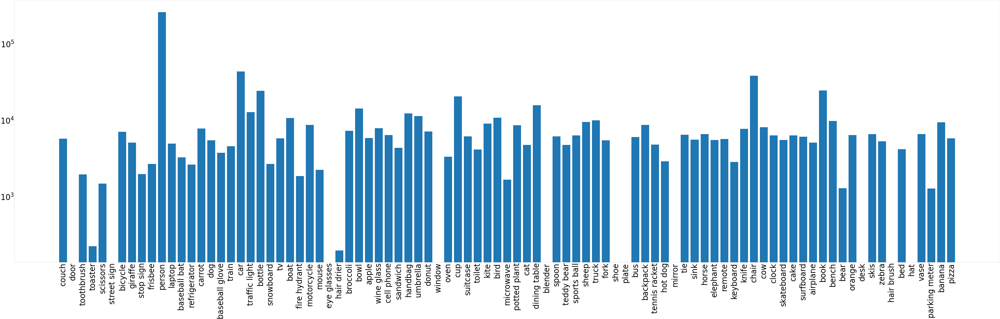

In [48]:
import matplotlib as plt
import numpy as np

# amounts = []
# for c in os.listdir("data/train"):
#     amounts.append((c, len(os.listdir("data/train/{0}".format(c)))))

# amounts = np.array(amounts)
plt.rcParams.update({'font.size': 170})
fig = plt.pyplot.figure(figsize=(300,80), dpi=10)
ax = fig.add_axes([0,0,1,1])
ax.bar(amounts[:,0], np.asarray(amounts[:,1],dtype=int))

plt.pyplot.yscale("log")
plt.pyplot.xticks(rotation=90)

print(min({x for x in np.asarray(amounts[:,1],dtype=int) if x > 0}))
print(amounts[:,1])

data/validation/pizza/1656799699601000000507037.jpg
data/validation/potted plant/1656799686123000000037777.jpg
data/validation/kite/1656799696160000000469192.jpg
data/validation/toothbrush/1656799689923000000413552.jpg


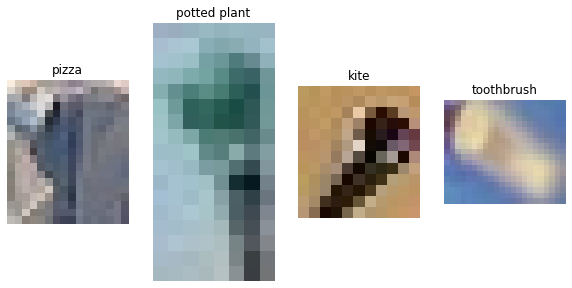

In [46]:
bad_imgs = ["data/validation/pizza/1656799699601000000507037.jpg",
"data/validation/potted plant/1656799686123000000037777.jpg",
"data/validation/kite/1656799696160000000469192.jpg",
"data/validation/toothbrush/1656799689923000000413552.jpg"]

plt.pyplot.figure(figsize=(10, 10))
plt.rcParams.update({'font.size': 10})
for i,x in enumerate(bad_imgs):
    print(x)
    augmented_images = cv2.imread(x)
    ax = plt.pyplot.subplot(1, 4, i + 1)
    ax.set_title(x.split('/')[2])
    #ax.set_title([name.split('/')[2] for name in bad_imgs])
    plt.pyplot.imshow(augmented_images.astype("uint8"))
    plt.pyplot.axis("off")

In [47]:
generate_dataset(TRAIN_ANNOTATIONS, TRAIN_IMAGES, TRAIN_OUTPUT_DIR, False)
generate_dataset(VAL_ANNOTATIONS, VAL_IMAGES, VAL_OUTPUT_DIR, False)

loading annotations into memory...
Done (t=12.07s)
creating index...
index created!
[262465, 7113, 43867, 8725, 5135, 6069, 4571, 9973, 10759, 12884, 1865, 0, 1983, 1285, 9838, 10806, 4768, 5508, 6587, 9509, 8147, 5513, 1294, 5303, 5131, 0, 8720, 11431, 0, 0, 12354, 6496, 6192, 2682, 6646, 2685, 6347, 9076, 3276, 3747, 5543, 6126, 4812, 24342, 0, 7913, 20650, 5479, 7770, 6165, 14358, 9458, 5851, 4373, 6399, 7308, 7852, 2918, 5821, 7179, 6353, 38491, 5779, 8652, 4192, 0, 15714, 0, 0, 4157, 0, 5805, 4970, 2262, 5703, 2855, 6434, 1673, 3334, 225, 5610, 2637, 0, 24715, 6334, 6613, 1481, 4793, 198, 1954, 0]
0 : 860001
1 : 860001
2 : 860001
3 : 860001
4 : 860001
5 : 860001
6 : 860001
7 : 860001
8 : 860001
9 : 860001
10 : 860001
11 : 860001
12 : 860001
13 : 860001
14 : 860001
15 : 860001
16 : 860001
17 : 860001
18 : 860001
19 : 860001
20 : 860001
21 : 860001
22 : 860001
23 : 860001
24 : 860001
25 : 860001
26 : 860001
27 : 860001
28 : 860001
29 : 860001
30 : 860001
31 : 860001
32 : 860001
33 :

91
2
['1401' '0' '17' '14' '61' '0' '317' '745' '292' '44' '20779' '976' '2'
 '945' '77' '1285' '20' '2163' '992' '70' '181' '38' '718' '570' '286'
 '1275' '30' '0' '6' '321' '1480' '193' '118' '229' '1002' '118' '575'
 '349' '0' '734' '332' '710' '702' '97' '339' '187' '481' '1977' '6592'
 '0' '6' '844' '7' '379' '1592' '5' '0' '0' '2086' '103' '33' '403' '0'
 '91' '249' '932' '1381' '103' '307' '25' '744' '623' '221' '59' '958'
 '179' '879' '366' '792' '508' '236' '0' '7' '809' '0' '2605' '0' '310'
 '188' '529' '1945']


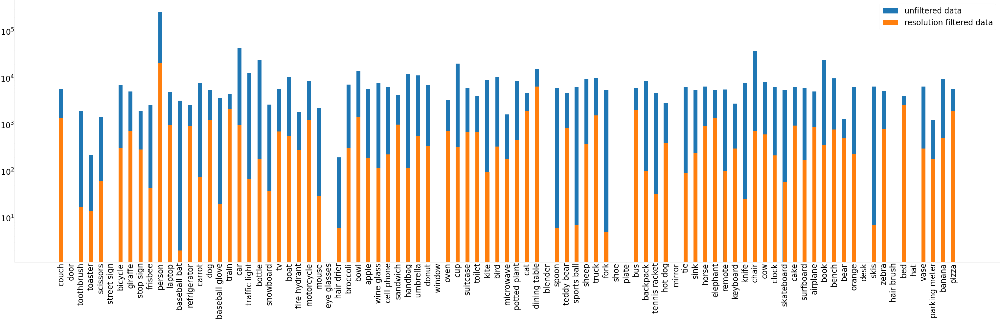

In [98]:
import matplotlib as plt
import numpy as np

classes = []
parsed_amounts = []
for c in os.listdir("data/train"):
    classes.append(c)
    parsed_amounts.append((c, len(os.listdir("data/train/{0}".format(c)))))

print(len(classes))
parsed_amounts = np.array(parsed_amounts)
plt.rcParams.update({'font.size': 170})
fig = plt.pyplot.figure(figsize=(300,80), dpi=10)
ax = fig.add_axes([0,0,1,1])

x_axis = np.arange(91)

tuplez = list(zip(amounts, parsed_amounts))
# print(tuplez[0])
# ax.bar(x_axis-300/91, tuplez[:,0], np.asarray(tuplez[:,1],dtype=int), label="original data")
# ax.bar(x_axis+300/91, tuplez[:,0], np.asarray(tuplez[:,1],dtype=int), label="40000 area")

ax.bar(x_axis+0, width=0.4, height=np.asarray(amounts[:,1],dtype=int), label="unfiltered data")
ax.bar(x_axis+0.001, width=0.4, height=np.asarray(parsed_amounts[:,1],dtype=int), label="resolution filtered data")
# for tup in tuplez:
#     print(tup)
#     print(int(tup[1][1]))
#     #ax.bar(x_axis)
#     ax.bar(x_axis+0.2, width=0.2, height=int(tup[1][1]))
#     #ax.bar(x_axis+300/91, tup[:,0], np.asarray(amounts[:,1],dtype=int), label="40000 area")

plt.pyplot.yscale("log")
plt.pyplot.xticks(rotation=90)
plt.pyplot.xticks(x_axis, classes)
plt.pyplot.legend()

print(min({x for x in np.asarray(parsed_amounts[:,1],dtype=int) if x > 0}))
print(parsed_amounts[:,1])

91
2
['1401' '0' '17' '14' '61' '0' '317' '745' '292' '44' '20779' '976' '2'
 '945' '77' '1285' '20' '2163' '992' '70' '181' '38' '718' '570' '286'
 '1275' '30' '0' '6' '321' '1480' '193' '118' '229' '1002' '118' '575'
 '349' '0' '734' '332' '710' '702' '97' '339' '187' '481' '1977' '6592'
 '0' '6' '844' '7' '379' '1592' '5' '0' '0' '2086' '103' '33' '403' '0'
 '91' '249' '932' '1381' '103' '307' '25' '744' '623' '221' '59' '958'
 '179' '879' '366' '792' '508' '236' '0' '7' '809' '0' '2605' '0' '310'
 '188' '529' '1945']


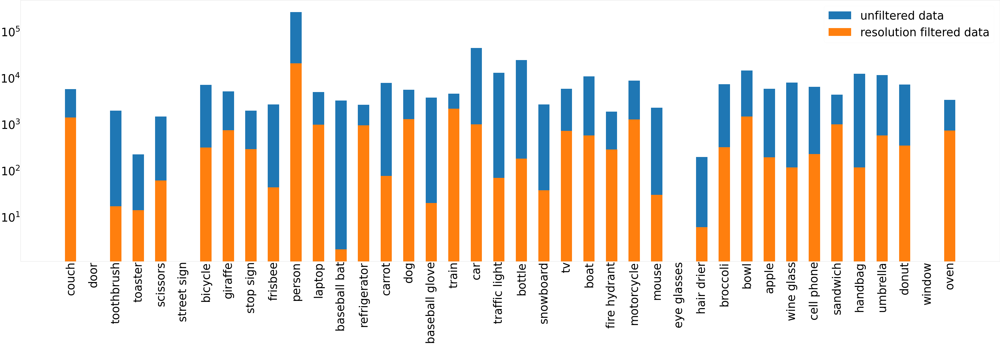

In [103]:
import matplotlib as plt
import numpy as np

classes = []
parsed_amounts = []
for c in os.listdir("data/train"):
    classes.append(c)
    parsed_amounts.append((c, len(os.listdir("data/train/{0}".format(c)))))

print(len(classes))
parsed_amounts = np.array(parsed_amounts)
plt.rcParams.update({'font.size': 250})
fig = plt.pyplot.figure(figsize=(300,80), dpi=10)
ax = fig.add_axes([0,0,1,1])

x_axis = np.arange(40)

tuplez = list(zip(amounts, parsed_amounts))
# print(tuplez[0])
# ax.bar(x_axis-300/91, tuplez[:,0], np.asarray(tuplez[:,1],dtype=int), label="original data")
# ax.bar(x_axis+300/91, tuplez[:,0], np.asarray(tuplez[:,1],dtype=int), label="40000 area")

ax.bar(x_axis+0, width=0.5, height=np.asarray(amounts[:40,1],dtype=int), label="unfiltered data")
ax.bar(x_axis+0.0001, width=0.5, height=np.asarray(parsed_amounts[:40,1],dtype=int), label="resolution filtered data")
# for tup in tuplez:
#     print(tup)
#     print(int(tup[1][1]))
#     #ax.bar(x_axis)
#     ax.bar(x_axis+0.2, width=0.2, height=int(tup[1][1]))
#     #ax.bar(x_axis+300/91, tup[:,0], np.asarray(amounts[:,1],dtype=int), label="40000 area")

plt.pyplot.yscale("log")
plt.pyplot.xticks(rotation=90)
plt.pyplot.xticks(x_axis, classes[:40])
plt.pyplot.legend()

print(min({x for x in np.asarray(parsed_amounts[:,1],dtype=int) if x > 0}))
print(parsed_amounts[:,1])